<a href="https://colab.research.google.com/github/sonhn85/scene-classification/blob/main/Scene_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In this notebook, we will try the process of implementing CNN with Keras in order to classify images.

I.   **Firstly**, we'll import useful packages.

II.   **Then**, we'll load the data, before visualize and preprocess it.

III.  **We'll try a simple CNN model** and then we will evaluate its performances.

IV.   **Finally,** we'll use techniques such as data augmentation, learning rate decay and dropout to increase our test F1.

# I. Let import all useful packages.

In [ ]:
import numpy as np
import tensorflow as tf
import random
import os

# To get reproducible result
seed = 8
os.environ['PYTHONHASHSEED'] = '0'
np.random.seed(seed)
random.seed(seed)
tf.random.set_seed(seed)

from tensorflow import keras
import tensorflow.keras.layers as Layers
import tensorflow.keras.models as Models
import tensorflow.keras.optimizers as Optimizer
from tensorflow.keras.initializers import Constant, RandomNormal
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.callbacks import ModelCheckpoint,TensorBoard
from tensorflow.keras.models import load_model
from tensorflow.keras.regularizers import L2
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, f1_score
import matplotlib.pyplot as plot

**Task 1:** Setting Fre GPU in this Google Colab notebook.

[*Hint.*](https://medium.com/deep-learning-turkey/google-colab-free-gpu-tutorial-e113627b9f5d)

## Mounting Google Drive locally
**Task 2:** Mount the Google Driver into the Google Colab Driver.

[*Hint.*](https://colab.research.google.com/notebooks/io.ipynb#scrollTo=eikfzi8ZT_rW)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


**Task 3**: Copy the zip dataset from Google Drive into Colab, then unzip it and finally remove the zip file to free up space.

[*Hint.*](https://medium.com/datadriveninvestor/speed-up-your-image-training-on-google-colab-dc95ea1491cf)

In [ ]:
!mkdir images
!cd images && unzip -q ../drive/MyDrive/Colab\ Notebooks/image-classification.zip

# II. Load the data.

## About dataset.
This is image data of Natural Scenes around the world.
This Data contains around 25k images of size 150x150 distributed under 6 categories. {'buildings' -> 0, 'forest' -> 1, 'glacier' -> 2, 'mountain' -> 3, 'sea' -> 4, 'street' -> 5 }

The Train, Test and Prediction data is separated in each zip files. There are around 14k images in Train, 3k in Test.


Now, We need to prepare our data to feed into the model. There is a builtin method in Keras that can extract your images from folder.

Following is the gernalized functions used to extract data from the directory.

In [ ]:
# Here's our 6 categories that we have to classify.
class_names = ['buildings', 'forest',
               'glacier', 'mountain', 'sea', 'street']
class_names_label = {'buildings': 0,
                     'forest' : 1,
                     'glacier' : 2,
                     'mountain' : 3,
                     'sea' : 4,
                     'street' : 5
                    }
nb_classes = 6

## Loading the Data

**Task 4:** We have to write a load_data function that load the training and test data ( which contain images and the labels) from the folder.

* **Load_data** function return **train_set** and **test_set**. Each set contains **images and labels**.
* Apply 2 augmentation transformations (**shear_range** = 0.2, **zoom_range** = 0.2), shuffle with seed = 8 and rescaling function( to [0, 1]) to **train_set.**
* Apply rescaling funtion to [0, 1]  to **test_set**, no shuffle.
* Batch size = 32.



[*Hint.*](https://keras.io/preprocessing/image/)


In [ ]:
# Custom callback to calculate F1 score at the end of each epoch
class F1Callback(keras.callbacks.Callback):
    def __init__(self, train_dataset, test_dataset):
        super().__init__()
        self.train_dataset = train_dataset
        self.test_dataset = test_dataset
        self.y_train = np.concatenate([y for x, y in train_dataset], axis=0).argmax(axis=1)
        self.y_test = np.concatenate([y for x, y in test_dataset], axis=0).argmax(axis=1)
    def on_epoch_end(self, epoch, logs=None):
        yhat = self.model.predict(self.train_dataset).argmax(axis=1)
        f1_train = f1_score(self.y_train, yhat, average='micro')
        logs['f1_score'] = f1_train

        yhat = self.model.predict(self.test_dataset).argmax(axis=1)
        f1_test = f1_score(self.y_test, yhat, average='micro')
        logs['val_f1_score'] = f1_test

def cache(ds, show=0):
    """
        Cache Dataset in memory for faster training
        Input: Dataset
               number of images to show
        Output: CacheDataset, number of element, image size
    """
    # Begin caching
    cache_ds = ds.cache()
    n = 0
    # Fully loop over the Dataset to cache
    show_done = False if show>0 else True
    for i, (X_batch, _) in enumerate(ds):
        bs = len(X_batch)
        n += bs
        if not show_done:
            n_chart = min(show, bs)
            fig = plot.figure(figsize=(3*n_chart, 3))
            X = X_batch.numpy()
            for i in range(n_chart):
                fig.add_subplot(1, n_chart, i+1)
                plot.imshow(X[i])
                plot.xticks([])
                plot.yticks([])
            plot.show()
            show_done = True
    px = X_batch.numpy().shape[1:3]

    return cache_ds, n, px

def load_images(directory, **args):

    dir_iter = ImageDataGenerator(
        rescale=args['rescale'],
        shear_range=args.get('shear_range', 0.0),
        zoom_range=args.get('zoom_range', 0.0),
        rotation_range=args.get('rotation_range', 0.0),
    ).flow_from_directory(
        directory,
        target_size=args['size'],
        classes=args['class_names'],
        batch_size=1,
        seed=args['seed'],
        shuffle=args['shuffle']
    )

    def gen_func():
        for i in range(dir_iter.n):
            X_batch, Y_batch = next(dir_iter)
            yield X_batch[0], Y_batch[0]

    # Convert from DirectoryGenerator to Dataset
    ds = tf.data.Dataset.from_generator(
        gen_func,
        output_signature=(
            tf.TensorSpec(shape=(*args['size'], 3), dtype=tf.float16),
            tf.TensorSpec(shape=(len(args['class_names']),), dtype=tf.int8),
        )
    )

    # Set batch size
    ds = ds.batch(args['batch_size'])

    return ds

In [ ]:
def load_data(data_directories):
    """
        Load the data:
            - 14,034 images to train the network.
            - 3000 images to evaluate how accurately the network learned to classify images.
        Input:
            Data directory.
        Return: 
            training_set, testing_set.
    """

    params = {
        'rescale': 1/255,
        'seed': seed,
        'size': (150, 150),
        'batch_size': 32,
        'class_names': class_names
    }
    more_params = {
        'shear_range': 0.2,
        'zoom_range': 0.2
    }
    training_set = load_images(data_directories[0], shuffle=True, **params, **more_params)
    testing_set = load_images(data_directories[1], shuffle=False, **params)

    return training_set, testing_set
data_directories = ['images/seg_train/seg_train/', 'images/seg_test/seg_test/']

In [ ]:
train_dataset, test_dataset = load_data(data_directories)

# Cache test set
test_dataset, n_test, _ = cache(test_dataset)

Found 14034 images belonging to 6 classes.
Found 3000 images belonging to 6 classes.


## Let's explore the dataset.
We can, for example, ask ourselves:

* How many training and testing examples do we have ?
* What is the size of the images ?
* What is the proportion of each observed category ?

As you see, The Training data is in shape of (Number of Training Images, Width of image, Height of image, Channel of image). This shape is very important. If you didnot resize the images to same size. It should be (No. of images,) shape. So, using this shape you cant feed the images to the model.


**Task 5:** Print out:

*  Number of training examples.
*  Number of testing examples.
* Size of each image.



In [ ]:
train_dataset, n_train, px = cache(train_dataset)

print('Number of training examples: ', n_train)
print('Number of testing examples: ', n_test)
print('Each image is of size: ', px)

Number of training examples:  14034
Number of testing examples:  3000
Each image is of size:  (150, 150)


**Task 6:** Plot a pie chart of the proportion of each class.
You need to show the name and proportion of each class on the pie chart.

*Hint:* [plot.pie](https://matplotlib.org/3.1.1/gallery/pie_and_polar_charts/pie_features.html#sphx-glr-gallery-pie-and-polar-charts-pie-features-py)

In [ ]:
def plot_pie(train_dataset, class_names):
    # Array to store class count
    count = np.zeros((len(class_names),))
    for _, Y in train_dataset.as_numpy_iterator():
        count += np.sum(Y, axis=0)
    plot.pie(count, labels=class_names, startangle=90, autopct='%.2f%%')
    plot.show()

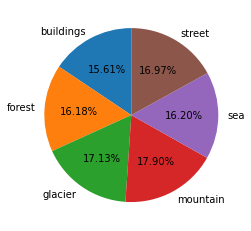

In [ ]:
plot_pie(train_dataset, class_names)

**Task 7**: Display the 36 random images from the training set.

* Each class contain 6 random images.
* Bellow the image, show the class it belongs to.

*Hint*: [plot.imshow](https://matplotlib.org/3.1.0/gallery/images_contours_and_fields/image_demo.html)

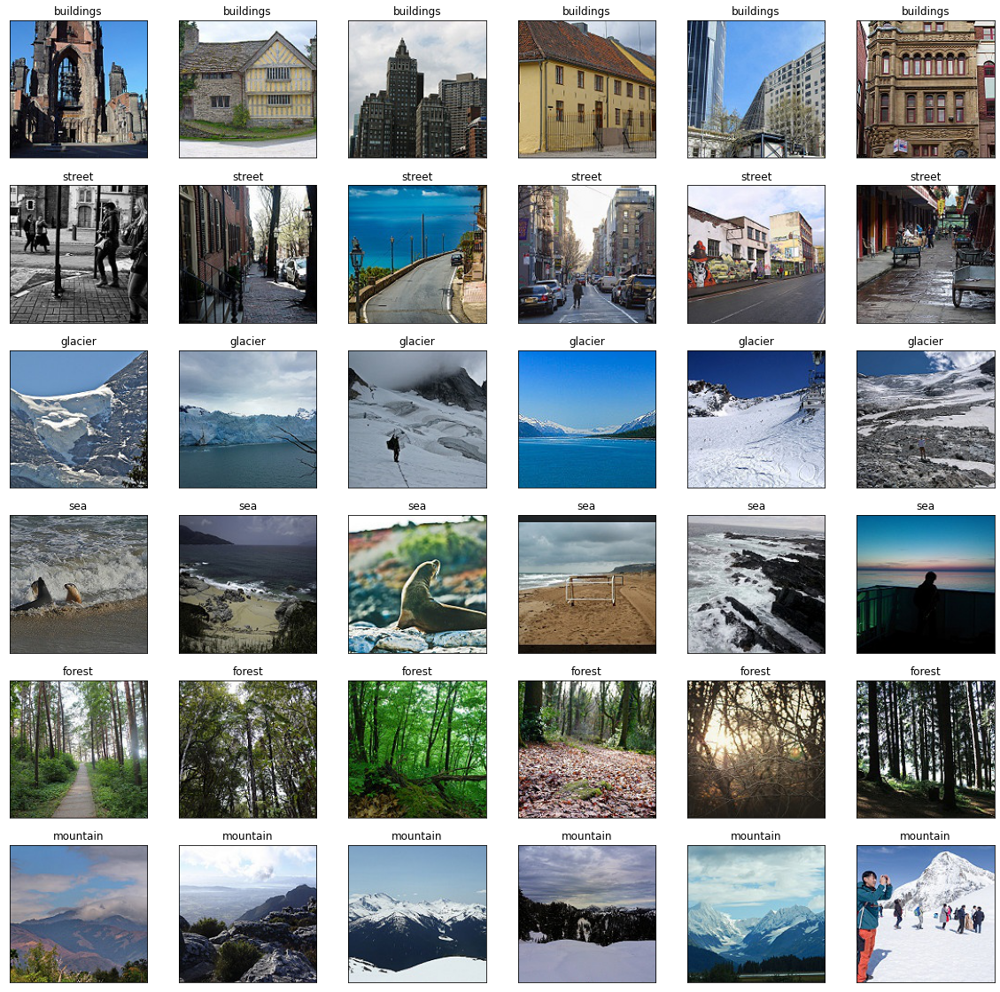

In [ ]:
def visualize_image(train_directory):
    fig = plot.figure(figsize=(20, 20))
    for i, t in enumerate(os.walk(train_directory)):
        if i == 0:
            continue
        else:
            label = t[0].split(os.path.sep)[-1]
            pick = np.random.randint(0, len(t[2]), 6)
            paths = [os.path.join(t[0], t[2][i]) for i in pick]
            for j, path in enumerate(paths):
                fig.add_subplot(6, 6, (i-1)*6 + j + 1)
                img_data =img_to_array(load_img(path)) / 255
                plot.imshow(img_data)
                plot.xticks([])
                plot.yticks([])
                plot.title(label)
    plot.show()

train_directory = 'images/seg_train/seg_train/'
visualize_image(train_directory)

# III. Modelling
## There are some steps we need to finish:
* Build the model.

* Compile the model.

* Train / fit the data to the model.

* Evaluate the model on the testing set.


## Build the model
We can build an easy model composed of different layers such as:

* [Conv2D](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Conv2D).

* [MaxPooling2D:](https://www.tensorflow.org/api_docs/python/tf/keras/layers/MaxPool2D) The images get smaller sized.

* [Flatten:](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Flatten) Transforms the format of the images from a 2d-array to a 1d-array of 150 150 3 pixel values.

* [Relu:](https://www.tensorflow.org/api_docs/python/tf/keras/layers/ReLU) given a value x, returns max(x, 0).

* [Softmax:](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Softmax) 6 neurons, probability that the image belongs to one of the classes.

* [Dense.](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dense)

* [Dropout.](https://www.tensorflow.org/api_docs/python/tf/keras/layers/Dropout)

**Task 8**: Buil a model, which contain these layers:
- Layer 1: Conv2D, 8 filters, kernel_size = (3, 3), activation = 'relu', input_shape = image_shape, same padding.
- Layer 2: Conv2D, 16 filters, kernel_size = (3, 3), activation = 'relu', same padding.
- Layer 3: MaxPooling2D, pooling size = (2, 2).
- Layer 4: Conv2D, 32 filters, kernel_size = (3, 3), activation = 'relu', same padding.
- Layer 5: Conv2D, 64 filters, kernel_size = (3, 3), activation = 'relu', same padding.
- Layer 6: MaxPooling2D, pooling size = (3, 3).
- Layer 7: Conv2D, 128 filters, kernel_size = (3, 3), activation = 'relu', same padding.
- Layer 8: Conv2D, 256 filters, kernel_size = (3, 3), activation = 'relu', same padding.
- Layer 9: MaxPooling2D, pooling size = (5, 5).
- Layer 10: Flatten.
- Layer 11: Dense with number of unit = 100, activation = 'relu'.
- Layer 12: Dropout with probs = 0.5.
- Layer 13: Final dense with number of unit = number of class, activation = 'softmax'.



All the Conv2D and Dense layers are followed by a Batch Norm layer with customized configuration excepts from the last dense layer:

- momentum=0.95 
- epsilon=0.005
- beta_initializer = RandomNormal with mean = 0 and stddev = 0.05
- gammaa_initializer = Constant with value = 0.9


In [ ]:
def create_model():
    '''
    Return: 
        CNN model with 13 layers.
    '''
    model = Models.Sequential([
        # Layer 1: Conv2D, 8 filters, kernel_size = (3, 3), activation = 'relu', input_shape = image_shape, same padding.
        Layers.Conv2D(8, (3, 3), padding='same', activation='relu', input_shape=(*px, 3), name='Layer1'),
        Layers.BatchNormalization(momentum=0.95, epsilon=0.005, gamma_initializer=Constant(0.9), beta_initializer=RandomNormal(0.0, 0.05)),
        # Layer 2: Conv2D, 16 filters, kernel_size = (3, 3), activation = 'relu', same padding.
        Layers.Conv2D(16, (3, 3), padding='same', activation='relu', name='Layer2'),
        Layers.BatchNormalization(momentum=0.95, epsilon=0.005, gamma_initializer=Constant(0.9), beta_initializer=RandomNormal(0.0, 0.05)),
        # Layer 3: MaxPooling2D, pooling size = (2, 2).
        Layers.MaxPooling2D(pool_size=(2, 2), name='Layer3'),
        # Layer 4: Conv2D, 32 filters, kernel_size = (3, 3), activation = 'relu', same padding.
        Layers.Conv2D(32, (3, 3), activation='relu', padding='same', name='Layer4'),
        Layers.BatchNormalization(momentum=0.95, epsilon=0.005, gamma_initializer=Constant(0.9), beta_initializer=RandomNormal(0.0, 0.05)),
        # Layer 5: Conv2D, 64 filters, kernel_size = (3, 3), activation = 'relu', same padding.
        Layers.Conv2D(64, (3, 3), activation='relu', padding='same', name='Layer5'),
        Layers.BatchNormalization(momentum=0.95, epsilon=0.005, gamma_initializer=Constant(0.9), beta_initializer=RandomNormal(0.0, 0.05)),
        # Layer 6: MaxPooling2D, pooling size = (3, 3).
        Layers.MaxPooling2D(pool_size=(3, 3), name='Layer6'),
        # Layer 7: Conv2D, 128 filters, kernel_size = (3, 3), activation = 'relu', same padding.
        Layers.Conv2D(128, (3, 3), activation='relu', padding='same', name='Layer7'),
        Layers.BatchNormalization(momentum=0.95, epsilon=0.005, gamma_initializer=Constant(0.9), beta_initializer=RandomNormal(0.0, 0.05)),
        # Layer 8: Conv2D, 256 filters, kernel_size = (3, 3), activation = 'relu', same padding.
        Layers.Conv2D(256, (3, 3), activation='relu', padding='same', name='Layer8'),
        Layers.BatchNormalization(momentum=0.95, epsilon=0.005, gamma_initializer=Constant(0.9), beta_initializer=RandomNormal(0.0, 0.05)),
        # Layer 9: MaxPooling2D, pooling size = (5, 5).
        Layers.MaxPooling2D(pool_size=(5, 5), name='Layer9'),
        # Layer 10: Flatten
        Layers.Flatten(name='Layer10'),
        # Layer 11: Dense with number of unit = 100, activation = 'relu'.
        Layers.Dense(100, activation='relu', name='Layer11'),
        Layers.BatchNormalization(momentum=0.95, epsilon=0.005, gamma_initializer=Constant(0.9), beta_initializer=RandomNormal(0.0, 0.05)),
        # Layer 12: Dropout with probs = 0.5.
        Layers.Dropout(0.5, name='Layer12'),
        # Layer 13: Final dense with number of unit = number of class, activation = 'softmax'.
        Layers.Dense(nb_classes, activation='softmax', name='Layer13')
    ])

    return model
model = create_model()

**Task 9:** Compile the model. Then print out the model summary.
* [Compile](https://keras.io/models/model/#compile) the model with Adam Optimizaer, lr = 1e-4, categorical-crossentroy loss and "[F1 score](https://github.com/tensorflow/addons/issues/825)" as metric.
* Print out the model F1.

In [ ]:
def optimize(model):
    '''
    Input: 
        Model.
    Return: 
        Complied model.
    '''
    ## TYPE YOUR CODE for task 9 here:
    model.compile(
        optimizer=Optimizer.Adam(learning_rate=1e-4),
        loss='categorical_crossentropy',
        metrics=['accuracy'],
    )
    
    return model
model = optimize(model)
print(model.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Layer1 (Conv2D)             (None, 150, 150, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 150, 150, 8)      32        
 ormalization)                                                   
                                                                 
 Layer2 (Conv2D)             (None, 150, 150, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 150, 150, 16)     64        
 hNormalization)                                                 
                                                                 
 Layer3 (MaxPooling2D)       (None, 75, 75, 16)        0         
                                                                 
 Layer4 (Conv2D)             (None, 75, 75, 32)        4

**Task 10**: Setup callback.
* Create the [tensorboard callback](https://www.tensorflow.org/tensorboard/tensorboard_in_notebooks) to save the logs.
* Create the [checkpoint callback](https://machinelearningmastery.com/check-point-deep-learning-models-keras/) to save the checkpoint with the best F1 after each epoch. 
* Create the [ReduceLROnPlateau callback](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ReduceLROnPlateau) to reduce learning rate when the validation F1 score has stopped improving with the factor of 0.1 and patience = 2.

In [ ]:
def callback_model(checkpoint_name, logs_name):
    '''
    Input: 
        Best checkpoint name, logs name.
    Return: 
        Callback list, which contains tensorboard callback and checkpoint callback.
    '''
    tensorboard_callback = TensorBoard(logs_name, histogram_freq=1)
    checkpoint_callback = ModelCheckpoint(
        filepath=os.path.join('ckpt', checkpoint_name),
        monitor='val_f1_score',
        save_best_only=True,
        mode='max'
    )
    reducelr_cb = tf.keras.callbacks.ReduceLROnPlateau(
        monitor='f1_score',
        factor=0.1,
        patience=2
    )
    f1callback = F1Callback(train_dataset, test_dataset)
    return [f1callback, tensorboard_callback, checkpoint_callback, reducelr_cb]

checkpoint_name = 'weights.best.hdf5'
logs_name = 'training_logs'
callbacks_list = callback_model(checkpoint_name, logs_name)

**Task 11:** Train the model.

**Requirement:** 
* Train the model with 10 epochs, generator = train_dataset, validataion_data = test_dataset.
* Return the model with best-checkpoint weights.

*Hint:*
[Fit](https://keras.io/models/sequential/#fit_generator) the model first, then reload the model ([load_model function](https://keras.io/getting-started/faq/)) with best-checkpoint weights.

In [ ]:
def train_model(model, callbacks_list):
    '''
    Input: 
        Model and callback list,
    Return: 
        Model with best-checkpoint weights.
    '''
    model.fit(
        x=train_dataset,
        epochs=10,
        validation_data=test_dataset,
        callbacks=callbacks_list
    )
    model = load_model(os.path.join('ckpt', checkpoint_name))

    return model

In [ ]:
# Delete old logs
!rm -r ckpt
!rm -r training_logs

model = train_model(model, callbacks_list)

rm: cannot remove 'ckpt': No such file or directory
rm: cannot remove 'training_logs': No such file or directory
Epoch 1/10
      6/Unknown - 12s 90ms/step - loss: 2.1217 - accuracy: 0.2552WARNING:tensorflow:Callback method `on_train_batch_end` is slow compared to the batch time (batch time: 0.0351s vs `on_train_batch_end` time: 0.0491s). Check your callbacks.
439/439 [==============================] - 67s 127ms/step - loss: 0.9852 - accuracy: 0.6389 - val_loss: 0.7229 - val_accuracy: 0.7557 - f1_score: 0.7872 - val_f1_score: 0.7557 - lr: 1.0000e-04
Epoch 2/10
439/439 [==============================] - 54s 123ms/step - loss: 0.6597 - accuracy: 0.7626 - val_loss: 0.5921 - val_accuracy: 0.7967 - f1_score: 0.8355 - val_f1_score: 0.7967 - lr: 1.0000e-04
Epoch 3/10
439/439 [==============================] - 54s 123ms/step - loss: 0.5418 - accuracy: 0.8085 - val_loss: 0.5231 - val_accuracy: 0.8223 - f1_score: 0.8748 - val_f1_score: 0.8223 - lr: 1.0000e-04
Epoch 4/10
439/439 [================

**Task 12**: [Show the tensorboard](https://www.tensorflow.org/tensorboard/tensorboard_in_notebooks) in the notebook.

In [ ]:
# Save best params and logs
!rm -r drive/MyDrive/Colab\ Notebooks/ckpt
!cp -r ckpt drive/MyDrive/Colab\ Notebooks/.
!rm -r drive/MyDrive/Colab\ Notebooks/training_logs
!cp -r training_logs drive/MyDrive/Colab\ Notebooks/.

In [ ]:
# Restore params and logs
!rm -r ckpt
!cp -r drive/MyDrive/Colab\ Notebooks/ckpt ckpt/
!rm -r training_logs
!cp -r drive/MyDrive/Colab\ Notebooks/training_logs training_logs/
model = load_model('ckpt/weights.best.hdf5')

rm: cannot remove 'ckpt': No such file or directory
rm: cannot remove 'training_logs': No such file or directory


In [ ]:
!ps -ef|grep tensorboard

root        2112    1439  0 18:33 ?        00:00:00 /bin/bash -c ps -ef|grep tensorboard
root        2114    2112  0 18:33 ?        00:00:00 grep tensorboard


In [ ]:
!kill -9 960

In [ ]:
# Show Tensorboard
%load_ext tensorboard
%tensorboard --logdir training_logs

<IPython.core.display.Javascript object>

**Task 13:** Prediction on test set.
* Complete the get_prediction_classes function.
* Print out the test F1. 

In [ ]:
def get_prediction_classes(model, prediction_dataset):
    '''
    Input: 
        Model and prediction dataset.
    Return: 
        Prediction list and groundtrurth list with predicted classes.
    '''

    yhat = model.predict(prediction_dataset).argmax(axis=1)
    truth = np.concatenate([y for x, y in prediction_dataset], axis=0).argmax(axis=1)
    return yhat, truth

In [ ]:
test_predictions, test_groundtruths = get_prediction_classes(model, test_dataset)

f1_score(test_groundtruths, test_predictions, average='micro')

0.8313333333333334

**Task 14:** Perform the predicted result on test set using confusion matrix.
Remember to show the class name in the confusion matrix. 

In [ ]:
def plot_confusion_matrix(predictions, groundtruth, class_names):
    mat = confusion_matrix(test_groundtruths, test_predictions)
    ConfusionMatrixDisplay(mat, display_labels=class_names).plot()
    plot.show()

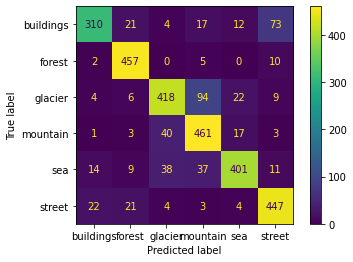

In [ ]:
plot_confusion_matrix(test_predictions, test_groundtruths, class_names)

**Task 15**: Model finetuning - fine tune the model using some of these approachs:
* Increase max epochs, change batch size.
* Play around with CNN, Dense and Dropoutlayers (add/# units/etc).
* Increase data augmentation transformations.
* Try to use a [pretrained model](https://www.tensorflow.org/api_docs/python/tf/keras/applications) on Keras.

Requirement: The val_best_F1 should be higher than 87%.

In [ ]:
batch_size = 64                # Increase batch size
px = (150, 150)

test_dataset = load_images(
    data_directories[1],
    rescale=1,                 # Not scale here but when training resnet50
    seed=seed,
    size=px,
    batch_size=batch_size,
    class_names=class_names,
    shuffle=False
)

train_dataset_1 = load_images(
    data_directories[0],
    rescale=1,
    seed=seed*2,
    size=px,
    batch_size=batch_size,
    class_names=class_names,
    zoom_range=[0.8, 1],       # Change zoom
    shuffle=True,
    rotation_range=5           # Rotate
)

train_dataset_2 = load_images(
    data_directories[0],
    rescale=1,
    seed=seed*3,
    size=px,
    batch_size=batch_size,
    class_names=class_names,
    zoom_range=[0.8, 1],       # Change zoom
    shuffle=True,
    rotation_range=5           # Rotate
).map(
    lambda X, Y: (tf.image.flip_left_right(X) , Y)  # Flip train set 2
)

# Concat train set 2 and train set 1
train_dataset = tf.data.Dataset.concatenate(train_dataset_1, train_dataset_2)
# Caching
test_dataset, n_test, _ = cache(test_dataset)
train_dataset, n_train, px = cache(train_dataset)

print('Number of training examples: ', n_train)
print('Number of testing examples: ', n_test)
print('Each image is of size: ', px)

Found 3000 images belonging to 6 classes.
Found 14034 images belonging to 6 classes.
Found 14034 images belonging to 6 classes.
Number of training examples:  28068
Number of testing examples:  3000
Each image is of size:  (150, 150)


In [ ]:
# Transfer learning: using rasnet50 model pretrain from imagenet
inputs = Layers.Input(shape=(*px, 3))
# Rasnet50 preprocessing
preprocess = keras.applications.resnet50.preprocess_input(inputs)
# Using custom final layer (sofmax with 6 classes)
resnet50 = keras.applications.resnet.ResNet50(
    include_top=False,
    weights='imagenet',
    input_shape=(*px, 3),
)
# Freeze pretrain weights
resnet50.trainable=False
pool = Layers.GlobalAveragePooling2D()
# Drop out 0.2
drop = Layers.Dropout(0.2)
# Add L2 regularization
soft = Layers.Dense(nb_classes, activation='softmax', kernel_regularizer=L2())

x = resnet50(preprocess)
x = pool(x)
x = drop(x)
outputs = soft(x)

model = keras.Model(inputs=inputs, outputs=outputs)
model.summary()

94781440/94765736 [==============================] - 1s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 tf.__operators__.getitem (S  (None, 150, 150, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 150, 150, 3)      0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                              

In [ ]:
model.compile(
    optimizer=Optimizer.Adam(learning_rate=0.001),  # Increase learning rate
    loss='categorical_crossentropy',
    metrics=['accuracy'],
)

# Remove old logs
!rm -r ckpt_experiment
!rm -r training_logs_experiment
!mkdir ckpt_experiment

checkpoint_name = 'weights.hdf5'
logs_name = 'training_logs_experiment'

tensorboard_callback = TensorBoard(logs_name, histogram_freq=1)
checkpoint_callback = ModelCheckpoint(
    filepath=os.path.join('ckpt_experiment', checkpoint_name),
    monitor='val_f1_score',
    save_best_only=True,
    mode='max',
    save_weights_only=True
)
reducelr_cb = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='f1_score',
    factor=0.1,
    patience=1
)
f1callback = F1Callback(train_dataset, test_dataset)
earlystop = tf.keras.callbacks.EarlyStopping(         # Try early stop
    monitor='val_f1_score',
    min_delta=0.002,
    patience=2,
    mode='max'
)
callbacks_list = [
    f1callback,
    tensorboard_callback,
    checkpoint_callback,
    reducelr_cb,
    earlystop
]

history = model.fit(
    x=train_dataset,
    epochs=10,
    validation_data=test_dataset,
    callbacks=callbacks_list
)
model.load_weights(os.path.join('ckpt_experiment', checkpoint_name))

rm: cannot remove 'ckpt_experiment': No such file or directory
rm: cannot remove 'training_logs_experiment': No such file or directory


/usr/local/lib/python3.7/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


Epoch 1/10
440/440 [==============================] - 223s 479ms/step - loss: 0.3961 - accuracy: 0.8902 - val_loss: 0.2791 - val_accuracy: 0.9200 - f1_score: 0.9359 - val_f1_score: 0.9200 - lr: 0.0010
Epoch 2/10
440/440 [==============================] - 206s 470ms/step - loss: 0.2598 - accuracy: 0.9241 - val_loss: 0.2534 - val_accuracy: 0.9243 - f1_score: 0.9422 - val_f1_score: 0.9243 - lr: 0.0010
Epoch 3/10
440/440 [==============================] - 207s 470ms/step - loss: 0.2186 - accuracy: 0.9369 - val_loss: 0.2410 - val_accuracy: 0.9290 - f1_score: 0.9442 - val_f1_score: 0.9290 - lr: 1.0000e-04
Epoch 4/10
440/440 [==============================] - 206s 469ms/step - loss: 0.2141 - accuracy: 0.9385 - val_loss: 0.2370 - val_accuracy: 0.9290 - f1_score: 0.9453 - val_f1_score: 0.9290 - lr: 1.0000e-05
Epoch 5/10
440/440 [==============================] - 206s 470ms/step - loss: 0.2116 - accuracy: 0.9401 - val_loss: 0.2369 - val_accuracy: 0.9293 - f1_score: 0.9453 - val_f1_score: 0.9293 

In [ ]:
# Save best weights and logs
!rm -r drive/MyDrive/Colab\ Notebooks/ckpt_experiment
!cp -r ckpt_experiment drive/MyDrive/Colab\ Notebooks/.
!rm -r drive/MyDrive/Colab\ Notebooks/training_logs_experiment
!cp -r training_logs_experiment drive/MyDrive/Colab\ Notebooks/.

In [ ]:
# Restore weights and logs
!rm -r ckpt_experiment
!cp -r drive/MyDrive/Colab\ Notebooks/ckpt_experiment ckpt_experiment/
!rm -r training_logs_experiment
!cp -r drive/MyDrive/Colab\ Notebooks/training_logs_experiment training_logs_experiment/
model.load_weights(os.path.join('ckpt_experiment', checkpoint_name))

In [ ]:
test_predictions, test_groundtruths = get_prediction_classes(model, test_dataset)

f1_score(test_groundtruths, test_predictions, average='micro')

0.9293333333333333

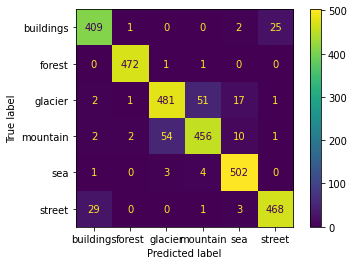

In [ ]:
plot_confusion_matrix(test_predictions, test_groundtruths, class_names)

In [ ]:
!ps -ef|grep tensorboard

root         890      70 12 14:45 ?        00:00:04 python3 /usr/local/bin/tensorboard --logdir training_logs_experiment
root         900     890  0 14:45 ?        00:00:00 /usr/local/lib/python3.7/dist-packages/tensorboard_data_server/bin/server --logdir=training_logs_experiment --reload=5 --samples-per-plugin= --port=0 --port-file=/tmp/tensorboard_data_server_xgh1kb91/port --die-after-stdin --error-file=/tmp/tensorboard_data_server_xgh1kb91/startup_error
root         939      70  7 14:46 ?        00:00:00 /bin/bash -c ps -ef|grep tensorboard
root         941     939  0 14:46 ?        00:00:00 grep tensorboard


In [ ]:
# Show Tensorboard
%load_ext tensorboard
%tensorboard --logdir training_logs_experiment

<IPython.core.display.Javascript object>

Found 7301 images belonging to 1 classes.


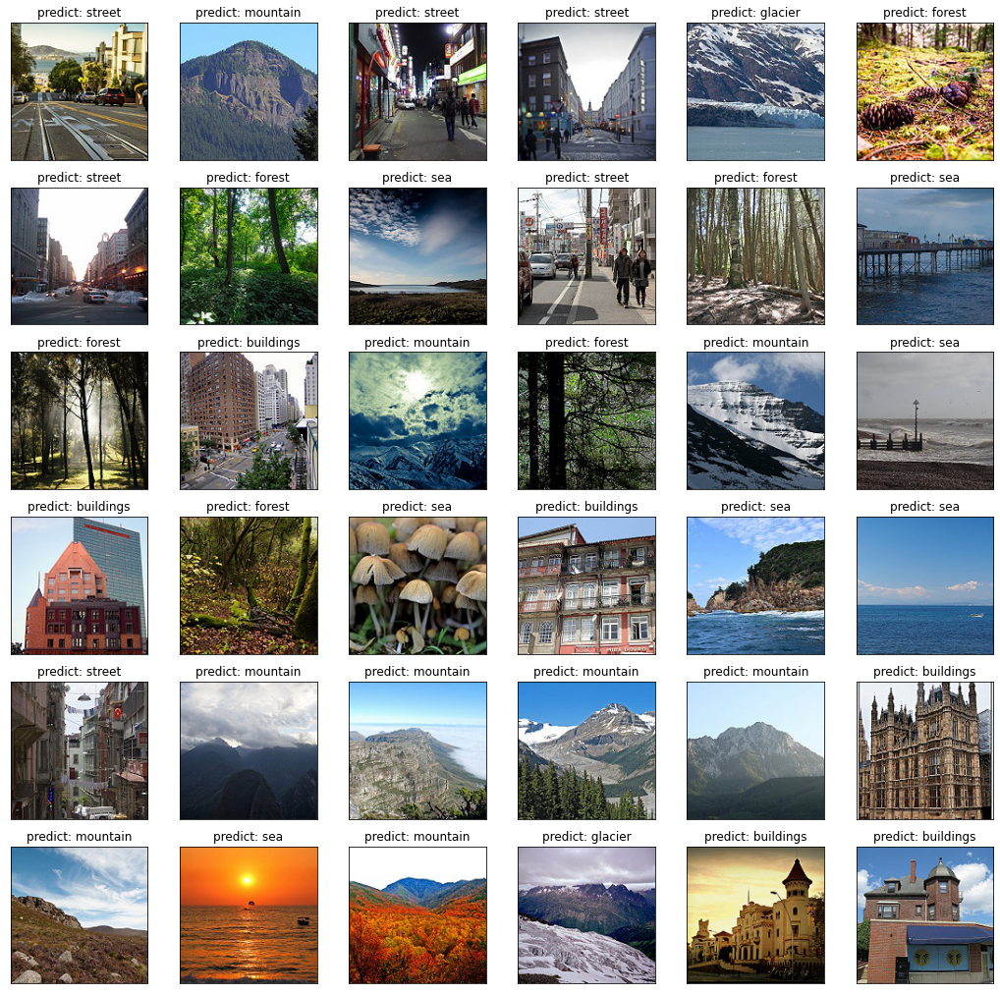

In [ ]:
prediction_dataset = ImageDataGenerator().flow_from_directory(
    'images/seg_pred/',
    target_size=px,
    class_mode=None,
    seed=seed*4,
    batch_size=36,
)
batch = next(prediction_dataset)

yhat = model.predict(batch).argmax(axis=1)

fig = plot.figure(figsize=(18, 18))
for i in range(36):
    fig.add_subplot(6, 6, i+1)
    plot.imshow(batch[i]/255)
    plot.title('predict: ' + class_names[yhat[i]])
    plot.xticks([])
    plot.yticks([])